# Face alignment
## Machine Learning / Deep Learning
### This notebook presents some tests on face alignment, using some existing open source face detection solutions / toolkits.
#### The dataset used in this example consists of images of people (mostly families) manually collected from the web. (see [this notebook](https://github.com/nbishdev/simple_face_detection/blob/main/face_detection.ipynb)).
This notebook uses Python version 3.7 or newer.

Let's start by checking the Python version.

In [1]:
import sys

if int(sys.version[0]) < 3 or int(sys.version[2]) < 7:
    assert("Python version 3.7 or newer is required")

We continue by importing the necessary libraries and toolkits.

In [2]:
from PIL import Image
import cv2
import dlib
import math
import numpy as np
import os
import random
import shutil
import time

np.random.seed(1531)
random.seed(1531)

## Data Exploration

In [3]:
def display_images(paths, image_dims=(250, 250)):
    n = len(paths)
    m = int(math.sqrt(n))
    
    minw, minh = image_dims
    collage = Image.new("RGBA", (m*minw, m*minh), color=(255,255,255,255))
    
    c = 0
    for i in range(0, m*minw, minw):
        for j in range(0, m*minh, minh):
            file = paths[c]
            photo = Image.open(file).convert("RGBA")
            photo = photo.resize((minw,minh), Image.ANTIALIAS)
            collage.paste(photo, (i, j))
            c += 1
    
    collage.show()

Let's display a collage of randomly selected samples from the dataset.

In [4]:
CUR_PATH = os.path.abspath('')
DATASET_PATH = CUR_PATH + '/dataset/original'
images = [f'{DATASET_PATH}/{f}' for f in os.listdir(DATASET_PATH) if os.path.isfile(os.path.join(DATASET_PATH, f))]
print(f"Number of images in dataset: {len(images)}")

Number of images in dataset: 62


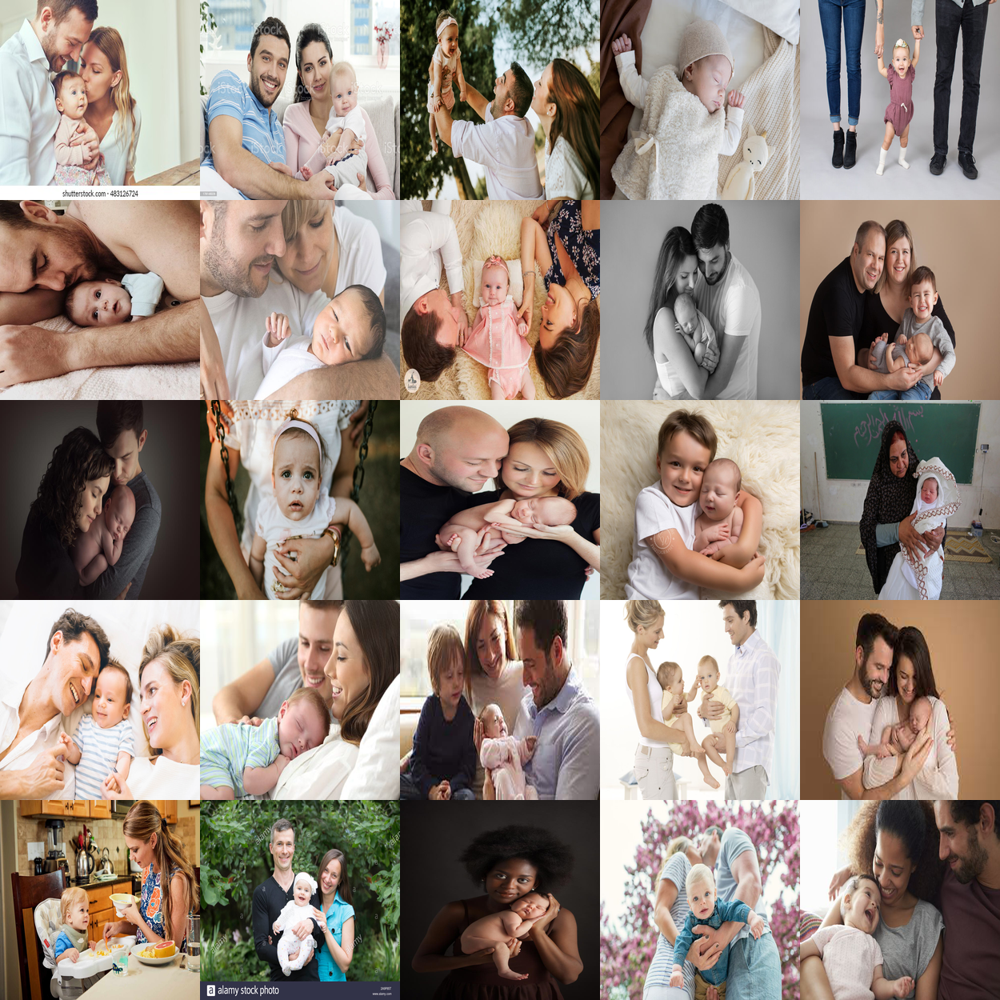

In [5]:
display = random.sample(images, min(len(images), 25))
display_images(display)

# YOLO5Face Face Detector

In order to detect faces YOLOv5-based face detection is employed. This model not only detects faces, but it also detects the 5 basic facial landmarks (eyes, nose and lips corners). 

Let's define some functions, parameters and variables which will be used in face detection, extraction and store.

In [6]:
MIN_FACE_WIDTH = 10
IMG_WIDTH = 416
CONF_THRESHOLD = 0.5
NMS_THRESHOLD = 0.4

YOLO_PATH = CUR_PATH + '/yoloface5'
MODEL_PATH = YOLO_PATH + '/models/yolov5n.yaml'
WEIGHTS_PATH = YOLO_PATH + '/weights/yolov5n_state_dict.pt'

inputs = []

In [7]:
if not os.path.isdir(YOLO_PATH):
    !git clone https://github.com/elyha7/yoloface.git
    !mv {CUR_PATH}/yoloface {YOLO_PATH}

sys.path.insert(0, os.path.abspath(YOLO_PATH))

In [8]:
# Remove the bounding boxes with low confidence
def post_process_yolo5(frame, bboxes):    
    frame_height = frame.shape[0]
    frame_width = frame.shape[1]
    
    final_boxes = []
    
    for box in bboxes:            
        left, top = max(box[0], 0.), max(box[1], 0.)
        width, height = min(box[2] - left, frame_width - left), min(box[3] - top, frame_height - top)
        final_boxes.append((left, top, width, height))
    
    return final_boxes

Let's load the model.

In [9]:
from face_detector import YoloDetector


if cv2.cuda.getCudaEnabledDeviceCount():
    gpu = cv2.cuda.getCudaEnabledDeviceCount()
else:
    gpu = -1

detector = YoloDetector(weights_name=WEIGHTS_PATH, config_name=MODEL_PATH, gpu=gpu, min_face=MIN_FACE_WIDTH, target_size=IMG_WIDTH)

-1
/mnt/disk/dnn/yoloface5/weights/yolov5n_state_dict.pt


Now let's perform face extraction.

In [10]:
for image in images:
    cap = cv2.VideoCapture(image)
    _, frame = cap.read()
    cap.release()
    
    bboxes, points = detector.predict(img=frame, conf_thres=CONF_THRESHOLD, iou_thres=NMS_THRESHOLD)
    
    if len(bboxes) > 0:
        bboxes = post_process_yolo5(frame, bboxes)
        
        inputs.append((frame, bboxes, points))

Let's see how many faces we have detected

In [11]:
count = 0
for i in inputs:
    count += len(i[1])

print(f"Detected {count} faces in total")

Detected 165 faces in total


## Experimentation

In the following sections we are going to experiment with face aligners. We are going to test the following N face alignment models
* **OpenCV Haar cascade Eyes Detector**
* **Dlib 5-point Face Landmarking Detector**
* **YOLOv5Face 5 Facial Keypoints Detector**

and evaluate them based on
* **Total alignment time**
* **Total number of faces aligned**

In every experiment the aligned faces are extracted as independent images and stored in the respective experiment directory.

Furthermore, the facial landmarks detected and the respective connection lines eyes are drawn on the images and then the processed images are stored in the respective experiment directory.

Let's define some functions and variables which will be used in all experiments.

In [12]:
# Draw the predicted bounding box
def draw_box(frame, box):
    # Draw a bounding box.
    cv2.rectangle(frame, (box[0], box[1]), (box[0]+box[2], box[1]+box[3]), (0,0,255), 2)

def draw_circle(frame, point, conf=None):
    cv2.circle(frame, point, 5, (255, 0, 0) , -1)
    
def draw_triangle(frame, point_1, point_2, point_3):
    cv2.line(frame, point_1, point_2, (0,200,200), 2)
    cv2.line(frame, point_1, point_3, (0,200,200), 2)
    cv2.line(frame, point_2, point_3, (0,200,200), 2)

def draw_line(frame, point_1, point_2):
    cv2.line(frame, point_1, point_2, (0,200,200), 2)

In [13]:
aligner_names = []
alignment_times = []
alignment_counts = []

# OpenCV Haar Cascade Eye Detector

#### This is a very old, classic and simple straight eye detection algorithm, implemented in OpenCV which provides a pre-trained model.

The concept of this model is the use of Cascade of Classifiers. Instead of applying all 6000 image features on a 24x24 window, the features are grouped into different stages of classifiers and applied one-by-one. (Normally the first few stages will contain very many fewer features).

If a window fails the first stage, in which it considers the area as a non-eye part of image, discard it so we don't consider the remaining features on it.

If it passes, apply the second stage of features and continue the process. The window which passes all stages is a eye region.

You can find more details on this detector in the following URL:
https://docs.opencv.org/3.4/db/d28/tutorial_cascade_classifier.html

Let's define some parameters and variables which will be used in this experiment.

In [14]:
MIN_FACE_WIDTH = 10
MIN_FACE_HEIGHT = 10

FACES_PATH = CUR_PATH + '/aligned_haar'
DETECTED_PATH = CUR_PATH + '/detected_haar'

# create directory with faces
os.makedirs(FACES_PATH, exist_ok=True)
os.makedirs(DETECTED_PATH, exist_ok=True)

Let's load the model.

In [15]:
predictor = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_eye.xml")

Now let's run the experiment.

In [16]:
zero = 0
other = 0
count = 0
elapsed = 0

for data in inputs:
    frame = data[0]
    bboxes = data[1]
    
    for box in bboxes:
        face = frame[box[1]:box[1]+box[3], box[0]:box[0]+box[2]]
        
        eyes = predictor.detectMultiScale(face, minNeighbors=3, minSize=(MIN_FACE_WIDTH, MIN_FACE_HEIGHT))
        
        start = time.time()
        
        if len(eyes) == 0:
            cv2.imwrite(f'{FACES_PATH}/face_{count:0>3}.jpg', face, [cv2.IMWRITE_JPEG_QUALITY, 100])
            zero += 1
        elif len(eyes) != 2:
            cv2.imwrite(f'{FACES_PATH}/face_{count:0>3}.jpg', face, [cv2.IMWRITE_JPEG_QUALITY, 100])
            
            face_copy = face.copy()
            
            for eye in eyes:
                eye_center = (eye[0] + eye[2] // 2, eye[1] + eye[3] // 2)
                draw_box(face_copy, eye)
                draw_circle(face_copy, eye_center)

            cv2.imwrite(f'{DETECTED_PATH}/face_{count:0>3}.jpg', face_copy, [cv2.IMWRITE_JPEG_QUALITY, 100])

            other += 1
        else:
            eye_1 = None
            eye_2 = None
            
            # Creating for loop in order to divide one eye from another
            for (ex , ey,  ew,  eh) in eyes:
                if not eye_1:
                    eye_1 = (ex, ey, ew, eh)
                else:
                    eye_2 = (ex, ey, ew, eh)
            
            left_eye = None
            right_eye = None
            
            if eye_1[0] < eye_2[0]:
                left_eye = eye_1
                right_eye = eye_2
            else:
                left_eye = eye_2
                right_eye = eye_1
            
            # Calculating coordinates of a central points of the rectangles
            left_eye_center = (left_eye[0] + left_eye[2] // 2, left_eye[1] + left_eye[3] // 2)
            left_eye_x = left_eye_center[0] 
            left_eye_y = left_eye_center[1]
            
            right_eye_center = (right_eye[0] + right_eye[2] // 2, right_eye[1] + right_eye[3] // 2)
            right_eye_x = right_eye_center[0]
            right_eye_y = right_eye_center[1]
            
            A = None
            
            if left_eye_y > right_eye_y:
                # image will rotate in the clockwise direction
                A = (right_eye_x, left_eye_y)
            else:
                # image will rotate in the counter clockwise direction
                A = (left_eye_x, right_eye_y)
            
            delta_x = right_eye_x - left_eye_x
            delta_y = right_eye_y - left_eye_y
            angle = np.arctan(delta_y / delta_x)
            angle = (angle * 180) / np.pi
            
            elapsed += time.time() - start
            
            if angle != 0:
                count += 1
            
            
            # Width and height of the image
            h, w = face.shape[:2]
            # Calculating a center point of the image
            # Integer division "//"" ensures that we receive whole numbers
            center = (w // 2, h // 2)
            # Defining a matrix M and calling
            # cv2.getRotationMatrix2D method
            M = cv2.getRotationMatrix2D(center, (angle), 1.0)
            # Applying the rotation to our image using the
            # cv2.warpAffine method
            
            rotated = cv2.warpAffine(face.copy(), M, (w, h))
            cv2.imwrite(f'{FACES_PATH}/face_{count:0>3}.jpg', rotated, [cv2.IMWRITE_JPEG_QUALITY, 100])
            
            face_copy = face.copy()
            draw_box(face_copy, left_eye)
            draw_box(face_copy, right_eye)
            draw_circle(face_copy, left_eye_center)
            draw_circle(face_copy, right_eye_center)
            draw_circle(face_copy, A)
            draw_triangle(face_copy, A, right_eye_center, left_eye_center)
            
            cv2.imwrite(f'{DETECTED_PATH}/face_{count:0>3}.jpg', face_copy, [cv2.IMWRITE_JPEG_QUALITY, 100])
            
print(f"Elapsed time (sec): {elapsed}")
print(f"Number of faces aligned: {count}")
print(f"Number of faces with no eyes detected: {zero}")
print(f"Number of faces with more than 2 eyes detected: {other}")

Elapsed time (sec): 0.006282329559326172
Number of faces aligned: 43
Number of faces with no eyes detected: 47
Number of faces with more than 2 eyes detected: 72


In [17]:
aligner_names.append("OpenCV Haar Cascade Eye Detector")
alignment_times.append(elapsed)
alignment_counts.append(count)

Let's take a look at the face alignment result.

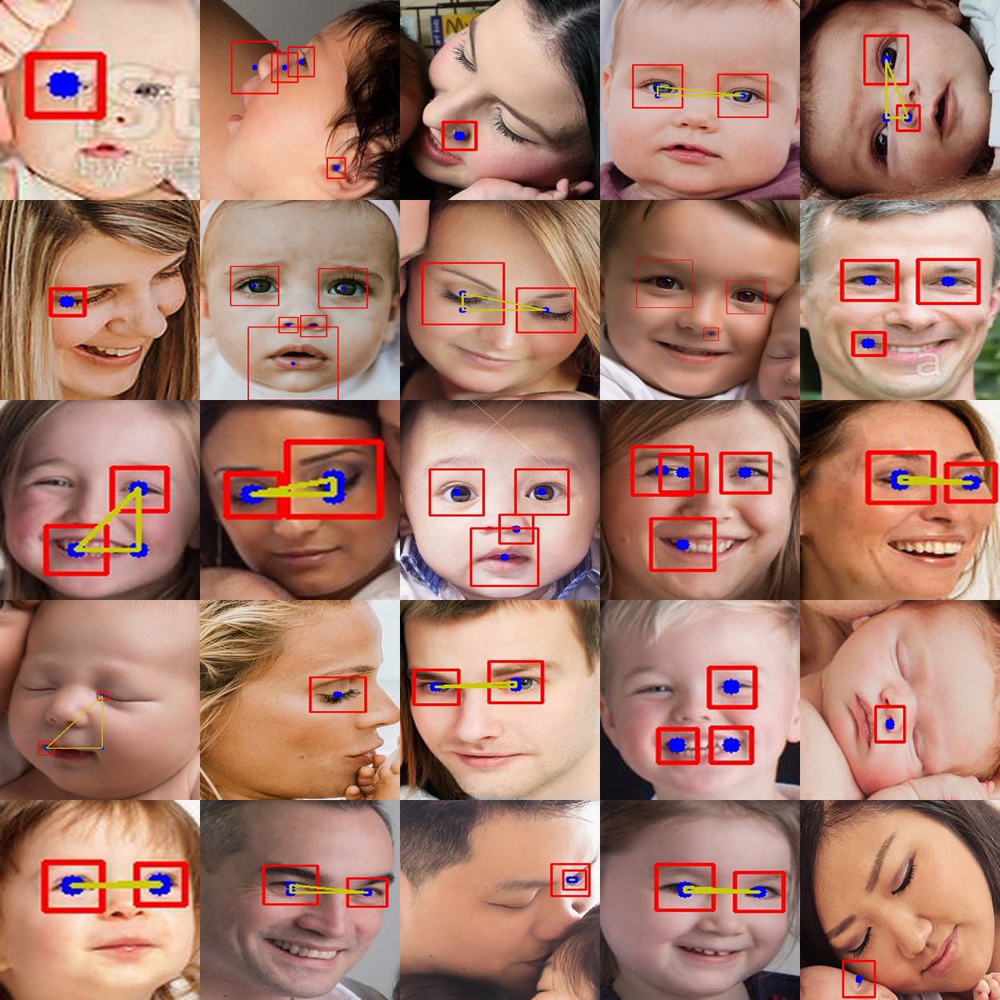

In [18]:
detects = [f'{DETECTED_PATH}/{f}' for f in os.listdir(DETECTED_PATH) if os.path.isfile(os.path.join(DETECTED_PATH, f))]
display = random.sample(detects, min(len(detects), 25))
display_images(display)

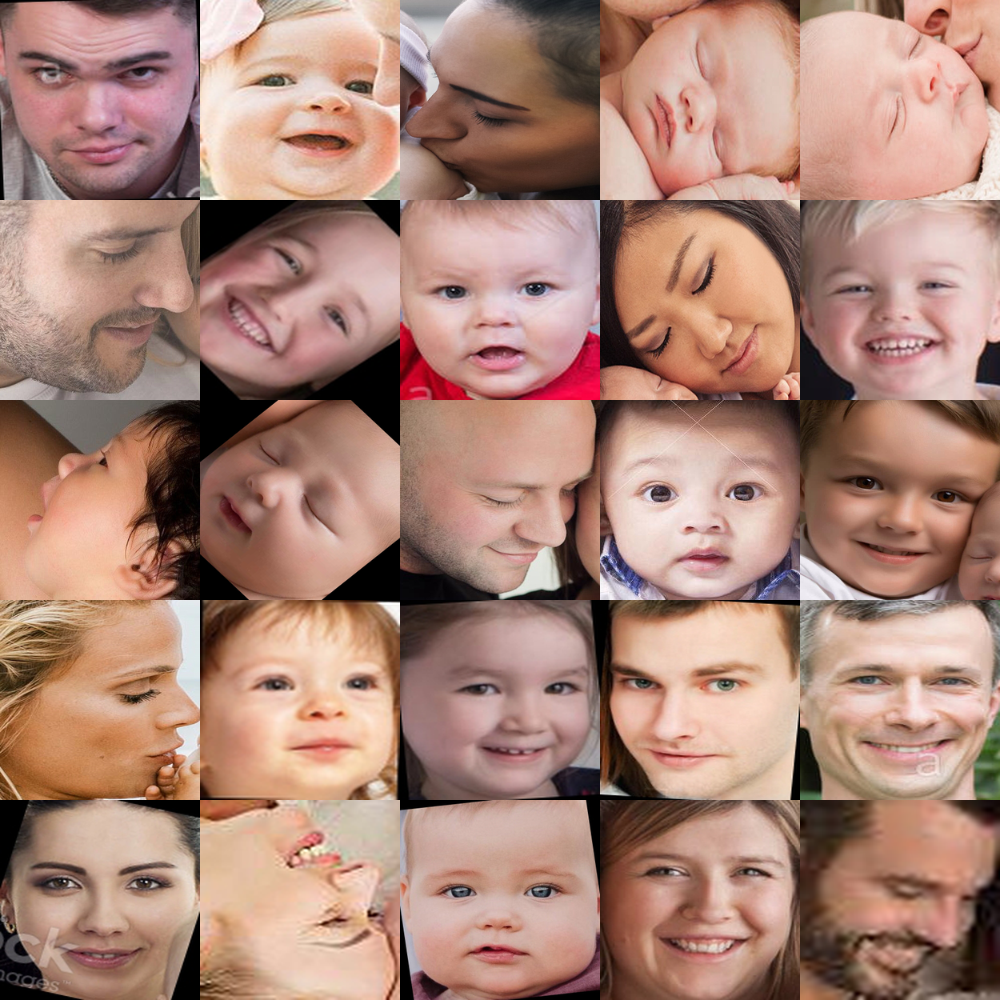

In [19]:
faces = [f'{FACES_PATH}/{f}' for f in os.listdir(FACES_PATH) if os.path.isfile(os.path.join(FACES_PATH, f))]
display = random.sample(faces, min(len(faces), 25))
display_images(display)

It is very obvious that this model performs really poorly.

We can see that if the model fails to align faces with only one eye detected.

Furthermore, in some cases the model has detected more than two eyes, which does not make sense (due to the fact that no photos of aliens were input).

# Dlib 5-point Face Landmarking Detector

This model detects the 3 basic facial landmarks (eyes and nose) as a list of 5 points (2 points for each eye and 1 point for the nose). 

Let's define some parameters and variables which will be used in this experiment.

In [20]:
FACES_PATH = CUR_PATH + '/aligned_landmark'
DETECTED_PATH = CUR_PATH + '/detected_landmark'
LANDMARK_PATH = CUR_PATH + '/hape_predictor_5_face_landmarks'
MODEL_PATH = LANDMARK_PATH + '/hape_predictor_5_face_landmarks.dat'

# create directory with the image name
os.makedirs(FACES_PATH, exist_ok=True)
os.makedirs(DETECTED_PATH, exist_ok=True)
os.makedirs(LANDMARK_PATH, exist_ok=True)

In [21]:
if not os.path.isfile(MODEL_PATH):
    !wget http://dlib.net/files/shape_predictor_5_face_landmarks.dat.bz2 -O {MODEL_PATH}.bz2
    !bzip2 -df {MODEL_PATH}.bz2 > {MODEL_PATH}

In [22]:
def shape_to_normal(shape):
    shape_normal = []
    for i in range(0, 5):
        shape_normal.append((i, (shape.part(i).x, shape.part(i).y)))
    return shape_normal

def get_eyes_nose_dlib(shape):
    nose = shape[4][1]
    left_eye_x = int(shape[3][1][0] + shape[2][1][0]) // 2
    left_eye_y = int(shape[3][1][1] + shape[2][1][1]) // 2
    right_eyes_x = int(shape[1][1][0] + shape[0][1][0]) // 2
    right_eyes_y = int(shape[1][1][1] + shape[0][1][1]) // 2
    return nose, (left_eye_x, left_eye_y), (right_eyes_x, right_eyes_y)

def distance(a, b):
    return np.sqrt((a[0] - b[0]) ** 2 + (a[1] - b[1]) ** 2)

def cosine_formula(length_line1, length_line2, length_line3):
    cos_a = -(length_line3 ** 2 - length_line2 ** 2 - length_line1 ** 2) / (2 * length_line2 * length_line1)
    return np.clip(cos_a, -1, 1)

def rotate_point(origin, point, angle):
    ox, oy = origin
    px, py = point

    qx = ox + np.cos(angle) * (px - ox) - np.sin(angle) * (py - oy)
    qy = oy + np.sin(angle) * (px - ox) + np.cos(angle) * (py - oy)
    return int(qx), int(qy)


def is_between(point1, point2, point3, extra_point):
    result = False
    
    c1 = (point2[0] - point1[0]) * (extra_point[1] - point1[1]) - (point2[1] - point1[1]) * (extra_point[0] - point1[0])
    c2 = (point3[0] - point2[0]) * (extra_point[1] - point2[1]) - (point3[1] - point2[1]) * (extra_point[0] - point2[0])
    c3 = (point1[0] - point3[0]) * (extra_point[1] - point3[1]) - (point1[1] - point3[1]) * (extra_point[0] - point3[0])
    if (c1 < 0 and c2 < 0 and c3 < 0) or (c1 > 0 and c2 > 0 and c3 > 0):
        result = True
    return result

Let's load the model.

In [23]:
predictor = dlib.shape_predictor(MODEL_PATH)

Now let's run the experiment.

In [24]:
elapsed = 0
count = 0

for data in inputs:
    frame = data[0].copy()
    bboxes = data[1]
    
    for box in bboxes:
        rect = dlib.rectangle(box[0], box[1], box[0]+box[2], box[1]+box[3])
        shape = predictor(frame, rect)
        
        start = time.time()
                
        shape = shape_to_normal(shape)
        nose_center, left_eye_center, right_eye_center = get_eyes_nose_dlib(shape)
        
        forehead_center = ((left_eye_center[0] + right_eye_center[0]) // 2, (left_eye_center[1] + right_eye_center[1]) // 2)
        top_center = (box[0] + int(box[2] / 2), box[1])
        
        length_line1 = distance(forehead_center, nose_center)
        length_line2 = distance(top_center, nose_center)
        length_line3 = distance(top_center, forehead_center)
        
        cos_a = cosine_formula(length_line1, length_line2, length_line3)
        angle = np.arccos(cos_a)
        
        rotated_point = rotate_point(nose_center, forehead_center, angle)
        
        if is_between(nose_center, forehead_center, top_center, rotated_point):
            angle = np.degrees(-angle)
        else:
            angle = np.degrees(angle)
        
        elapsed += time.time() - start
        
        if angle != 0:
            count += 1
        
        # Width and height of the image
        face = frame[box[1]:box[1]+box[3], box[0]:box[0]+box[2]]
        h, w = face.shape[:2]
        # Calculating a center point of the image
        # Integer division "//"" ensures that we receive whole numbers
        center = (w // 2, h // 2)
        # Defining a matrix M and calling
        # cv2.getRotationMatrix2D method
        M = cv2.getRotationMatrix2D(center, (angle), 1.0)
        # Applying the rotation to our image using the
        # cv2.warpAffine method

        rotated = cv2.warpAffine(face, M, (w, h))
        cv2.imwrite(f'{FACES_PATH}/face_{count:0>3}.jpg', rotated, [cv2.IMWRITE_JPEG_QUALITY, 100])

        draw_circle(frame, left_eye_center)
        draw_circle(frame, right_eye_center)
        draw_circle(frame, nose_center)
        draw_circle(frame, forehead_center)
        draw_line(frame, nose_center, forehead_center)
        draw_triangle(frame, nose_center, right_eye_center, left_eye_center)
        face = frame[box[1]:box[1]+box[3], box[0]:box[0]+box[2]]

        cv2.imwrite(f'{DETECTED_PATH}/face_{count:0>3}.jpg', face, [cv2.IMWRITE_JPEG_QUALITY, 100])

print(f"Elapsed time (sec): {elapsed}")
print(f"Number of faces aligned: {count}")

Elapsed time (sec): 0.0367734432220459
Number of faces aligned: 164


In [25]:
aligner_names.append("Dlib 5-point Face Landmarking Detector")
alignment_times.append(elapsed)
alignment_counts.append(count)

Let's take a look at the face alignment result.

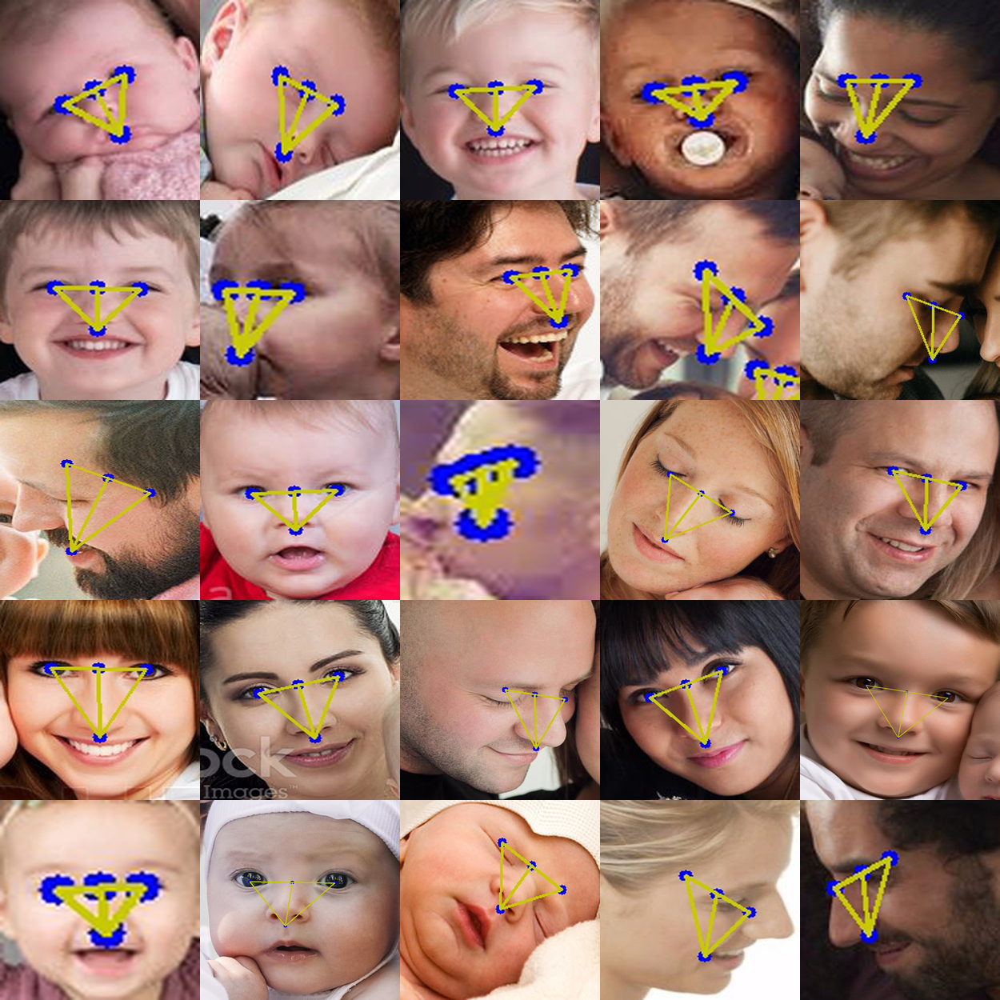

In [26]:
detects = [f'{DETECTED_PATH}/{f}' for f in os.listdir(DETECTED_PATH) if os.path.isfile(os.path.join(DETECTED_PATH, f))]
display = random.sample(detects, min(len(detects), 25))
display_images(display)

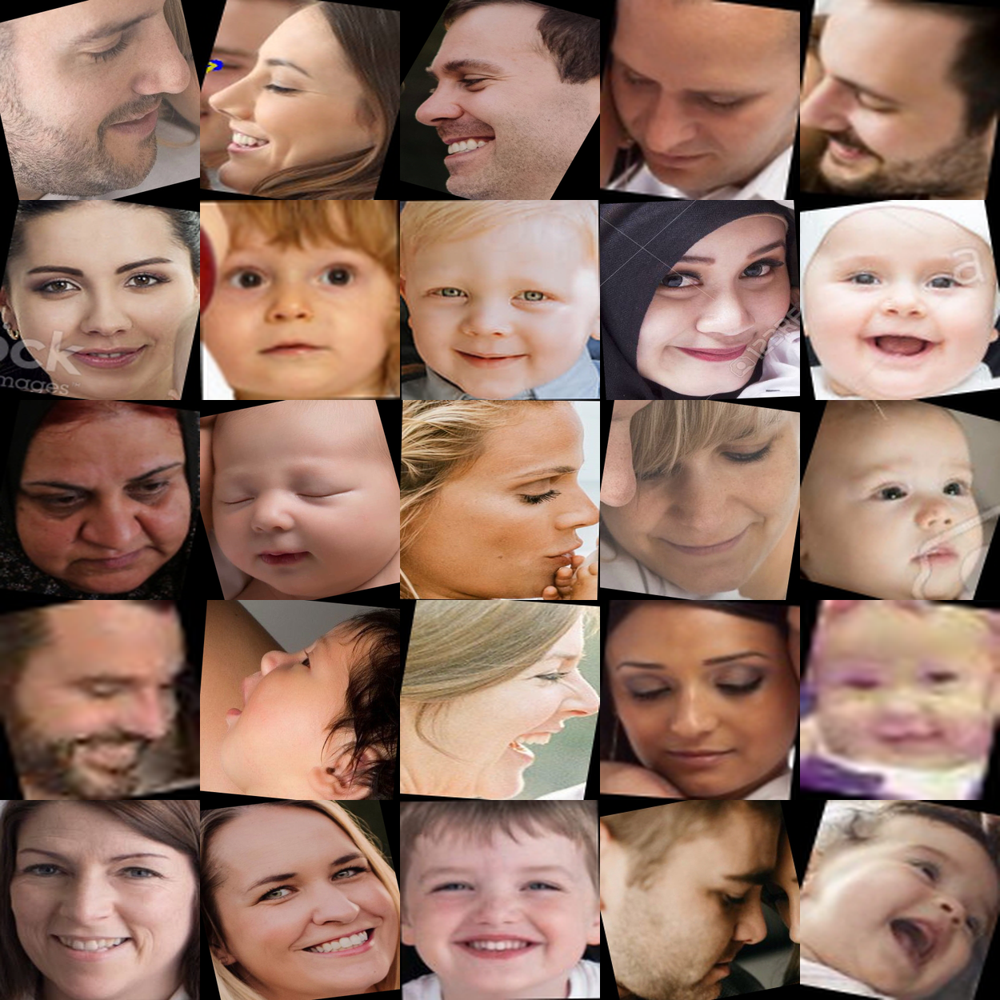

In [27]:
faces = [f'{FACES_PATH}/{f}' for f in os.listdir(FACES_PATH) if os.path.isfile(os.path.join(FACES_PATH, f))]
display = random.sample(faces, min(len(faces), 25))
display_images(display)

It is very obvious that this model performs much better than the Haar cascade.

We can see that it also has some difficulties in aligning faces with only one eye detected but not as much as the Haar cascade.

Furthermore, in some cases where the face is a profile with eyes that are not clear, has detected the eyes randomly.

# YOLO5Face 5 Facial Keypoints Detector

This model detects the 5 basic facial landmarks (eyes, nose and lips corners).

However, for the alignment we are only going to use the eyes and the nose.

Let's define some parameters and variables which will be used in this experiment.

In [28]:
FACES_PATH = CUR_PATH + '/aligned_yolo'
DETECTED_PATH = CUR_PATH + '/detected_yolo'

# create directory with the image name
os.makedirs(FACES_PATH, exist_ok=True)
os.makedirs(DETECTED_PATH, exist_ok=True)

Now let's run the experiment.

In [29]:
elapsed = 0
count = 0

for data in inputs:
    frame = data[0].copy()
    bboxes = data[1]
    landmarks = data[2]
    
    for box, points in zip(bboxes, landmarks):                
        start = time.time()
        
        left_eye_center = points[0]
        right_eye_center = points[1]
        nose_center = points[2]
        
        forehead_center = ((left_eye_center[0] + right_eye_center[0]) // 2, (left_eye_center[1] + right_eye_center[1]) // 2)
        top_center = (box[0] + int(box[2] / 2), box[1])
        
        length_line1 = distance(forehead_center, nose_center)
        length_line2 = distance(top_center, nose_center)
        length_line3 = distance(top_center, forehead_center)
        
        cos_a = cosine_formula(length_line1, length_line2, length_line3)
        angle = np.arccos(cos_a)
        
        rotated_point = rotate_point(nose_center, forehead_center, angle)
        
        if is_between(nose_center, forehead_center, top_center, rotated_point):
            angle = np.degrees(-angle)
        else:
            angle = np.degrees(angle)
        
        elapsed += time.time() - start
        
        if angle != 0:
            count += 1
        
        # Width and height of the image
        face = frame[box[1]:box[1]+box[3], box[0]:box[0]+box[2]]
        h, w = face.shape[:2]
        # Calculating a center point of the image
        # Integer division "//"" ensures that we receive whole numbers
        center = (w // 2, h // 2)
        # Defining a matrix M and calling
        # cv2.getRotationMatrix2D method
        M = cv2.getRotationMatrix2D(center, (angle), 1.0)
        # Applying the rotation to our image using the
        # cv2.warpAffine method

        rotated = cv2.warpAffine(face, M, (w, h))
        cv2.imwrite(f'{FACES_PATH}/face_{count:0>3}.jpg', rotated, [cv2.IMWRITE_JPEG_QUALITY, 100])

        
        draw_circle(frame, left_eye_center)
        draw_circle(frame, right_eye_center)
        draw_circle(frame, nose_center)
        draw_circle(frame, forehead_center)
        draw_line(frame, nose_center, forehead_center)
        draw_triangle(frame, nose_center, right_eye_center, left_eye_center)
        face = frame[box[1]:box[1]+box[3], box[0]:box[0]+box[2]]

        cv2.imwrite(f'{DETECTED_PATH}/face_{count:0>3}.jpg', face, [cv2.IMWRITE_JPEG_QUALITY, 100])

print(f"Elapsed time (sec): {elapsed}")
print(f"Number of faces aligned: {count}")

Elapsed time (sec): 0.026419639587402344
Number of faces aligned: 164


In [30]:
aligner_names.append("YOLO5Face 5 Facial Keypoints Detector")
alignment_times.append(elapsed)
alignment_counts.append(count)

Let's take a look at the face alignment result.

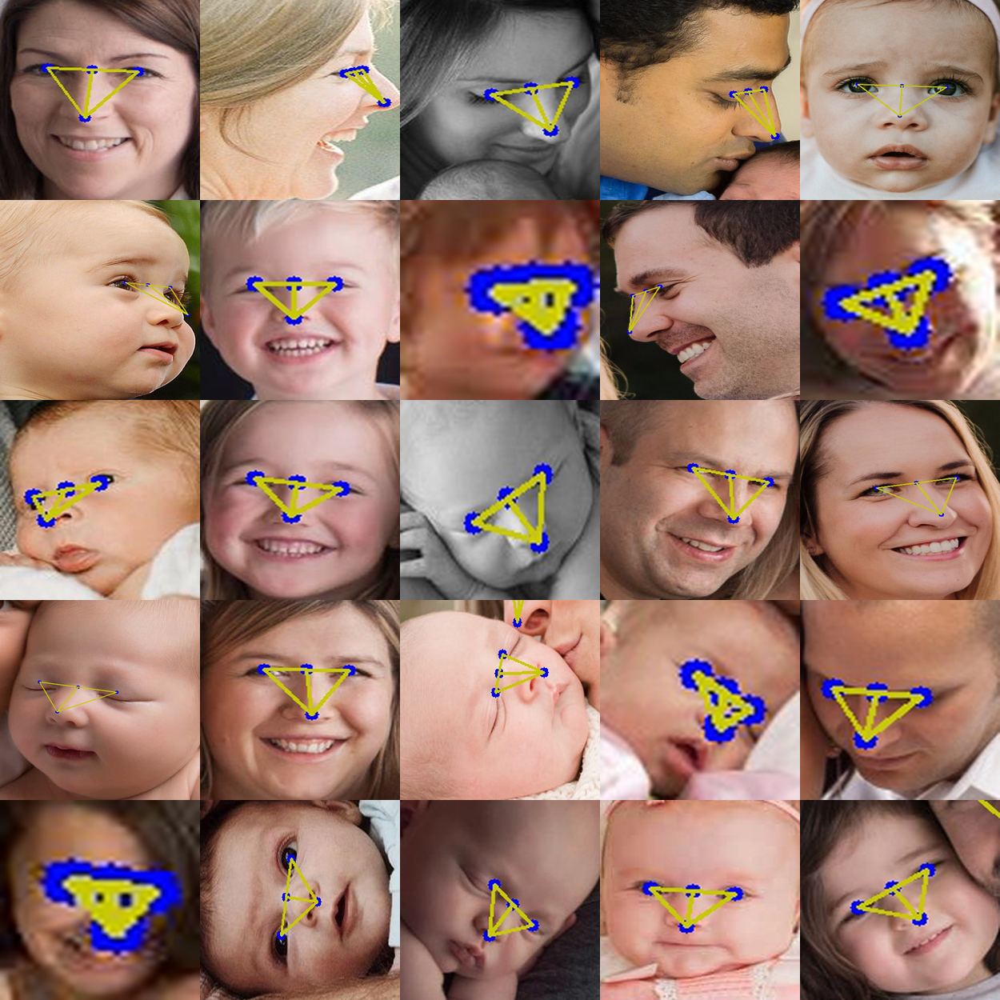

In [31]:
detects = [f'{DETECTED_PATH}/{f}' for f in os.listdir(DETECTED_PATH) if os.path.isfile(os.path.join(DETECTED_PATH, f))]
display = random.sample(detects, min(len(detects), 25))
display_images(display)

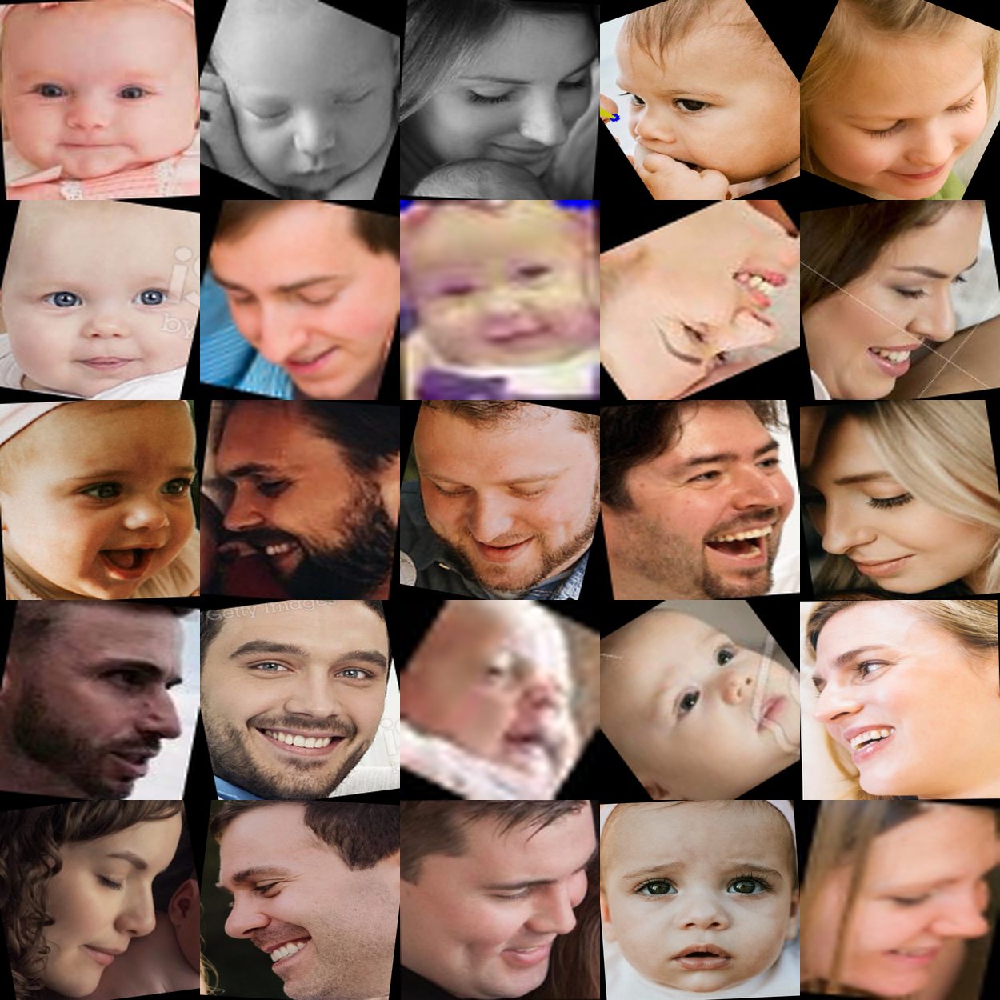

In [32]:
faces = [f'{FACES_PATH}/{f}' for f in os.listdir(FACES_PATH) if os.path.isfile(os.path.join(FACES_PATH, f))]
display = random.sample(faces, min(len(faces), 25))
display_images(display)

We can see that this model performs the best between the 3 models in this experiment.

# Results

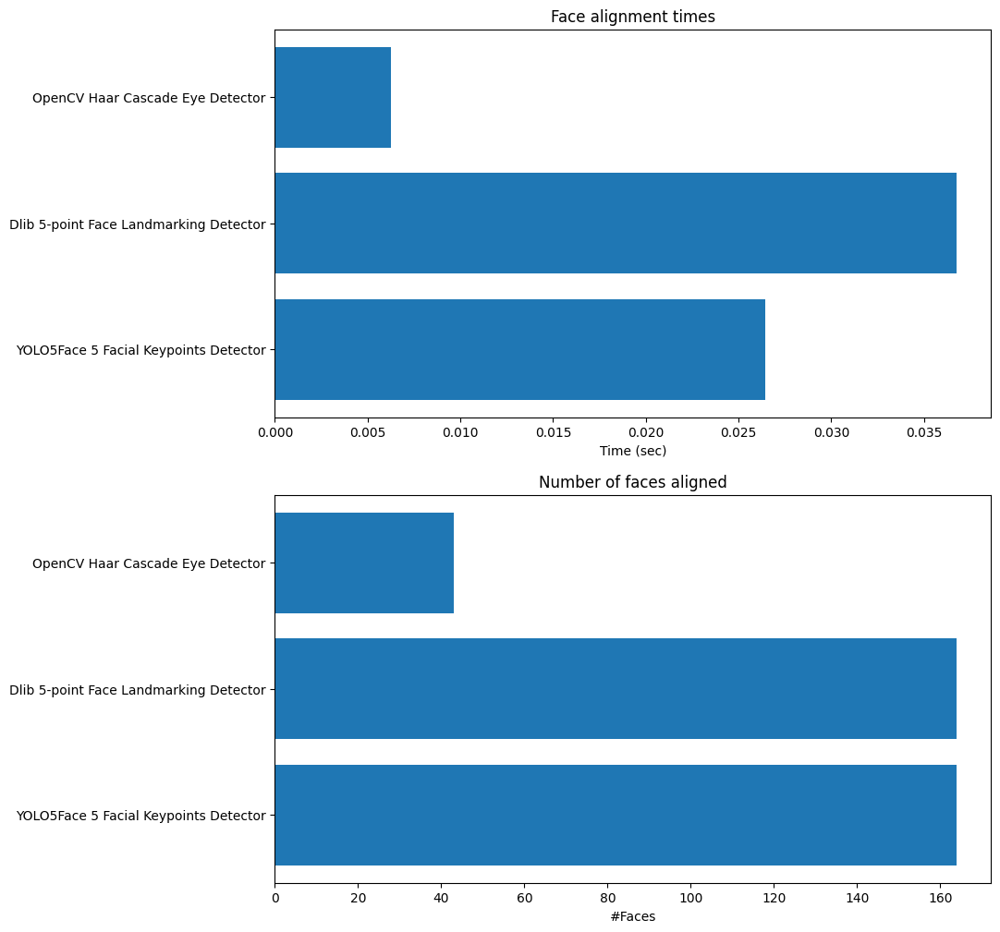

In [33]:
import matplotlib.pyplot as plt

%matplotlib inline


plt.rcdefaults()

fig, ax = plt.subplots(2, 1, figsize=[10,12])

y_pos = np.arange(len(aligner_names)).tolist()

ax[0].barh(y_pos, alignment_times, align='center')
ax[0].set_yticks(y_pos)
ax[0].set_yticklabels(aligner_names)
ax[0].invert_yaxis()
ax[0].set_xlabel('Time (sec)')
ax[0].set_title('Face alignment times')

ax[1].barh(y_pos, alignment_counts, align='center')
ax[1].set_yticks(y_pos)
ax[1].set_yticklabels(aligner_names)
ax[1].invert_yaxis()
ax[1].set_xlabel('#Faces')
ax[1].set_title('Number of faces aligned')

plt.show()

# Can we do better?

There exist more modern solution which detect more than these 5 facial landmarks and can result in much more sophisticated face alignment.

For example, [Dlib's 68-point facial landmark detector](http://dlib.net/face_landmark_detection.py.html) detects 68 points (as the name suggests).

Another example is the [Face Recognition software](https://github.com/1adrianb/face-alignment) which uses [Face Alignment Network](https://github.com/1adrianb/2D-and-3D-face-alignment)'s state-of-the-art deep learning based face alignment method.